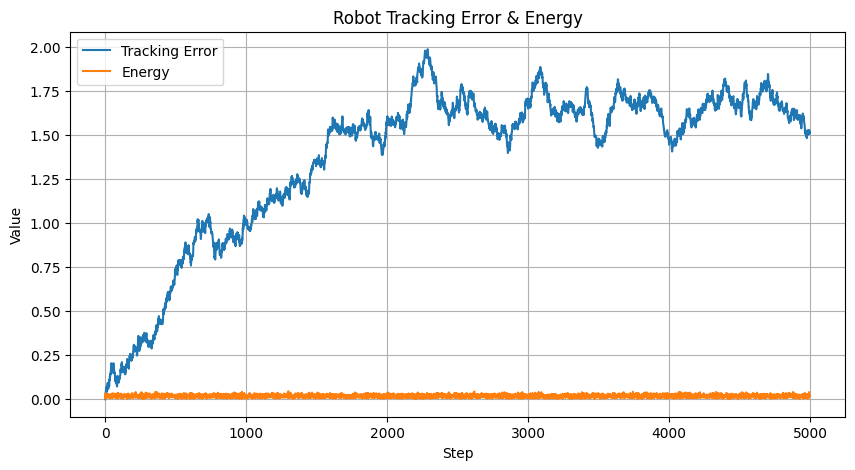

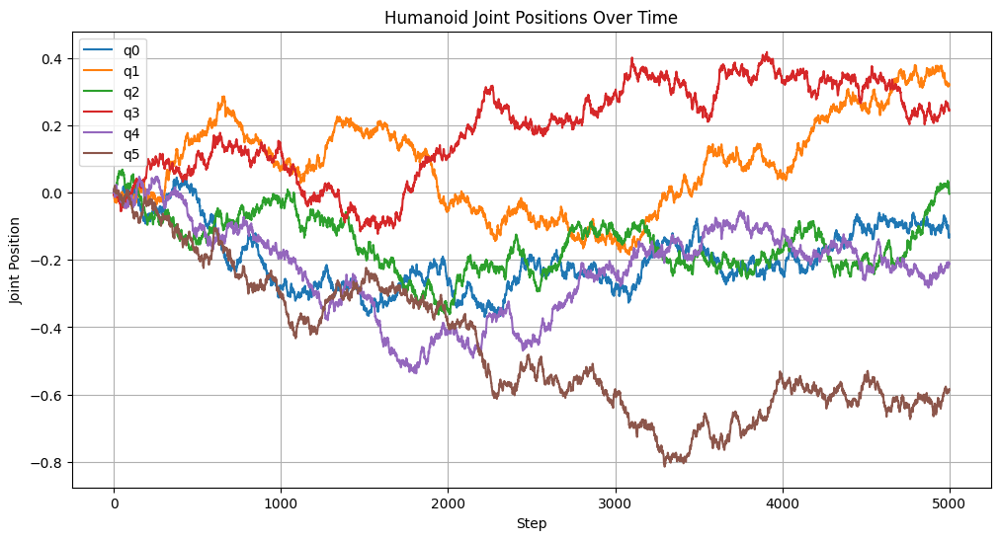

In [2]:
%matplotlib inline

import matplotlib.pyplot as plt
import matplotlib.animation as animation

import pandas as pd
import matplotlib.pyplot as plt

# Load log file
df = pd.read_csv("log.csv")

# Plot tracking error
plt.figure(figsize=(10,5))
plt.plot(df["step"], df["error"], label="Tracking Error")
plt.plot(df["step"], df["energy"], label="Energy")
plt.xlabel("Step")
plt.ylabel("Value")
plt.title("Robot Tracking Error & Energy")
plt.legend()
plt.grid(True)
plt.show()




joints = ["q0","q1","q2","q3","q4","q5"]
plt.figure(figsize=(12,6))
for j in joints:
    plt.plot(df["step"], df[j], label=j)
plt.xlabel("Step")
plt.ylabel("Joint Position")
plt.title("Humanoid Joint Positions Over Time")
plt.legend()
plt.grid(True)
plt.show()




Animation size has reached 20978635 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


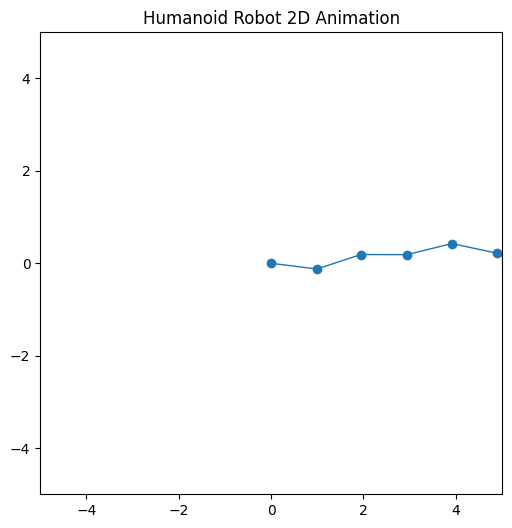

In [ ]:
# Import libraries
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML

# Load robot log
df = pd.read_csv("log.csv")

# Number of joints
n_joints = 6

# Compute 2D positions for animation (simple planar kinematics demo)
def joint_positions(frame):
    q = df.loc[frame, ["q0","q1","q2","q3","q4","q5"]].values
    x = [0]  # base at origin
    y = [0]
    for i in range(n_joints):
        x.append(x[-1] + np.cos(q[i]))  # simple 2D
        y.append(y[-1] + np.sin(q[i]))
    return x, y

# Setup figure
fig, ax = plt.subplots(figsize=(6,6))
line, = ax.plot([], [], 'o-', lw=1, markersize=6)
ax.set_xlim(-5, 5)
ax.set_ylim(-5, 5)
ax.set_aspect('equal')
ax.set_title("Humanoid Robot 2D Animation")

# Init function
def init():
    line.set_data([], [])
    return line,

# Update function
def update(frame):
    x, y = joint_positions(frame)
    line.set_data(x, y)
    return line,

# Animate
ani = animation.FuncAnimation(
    fig, update, frames=len(df), init_func=init, blit=True, interval=50
)

# Display animation inline in notebook
HTML(ani.to_jshtml())

from matplotlib.animation import PillowWriter

# Save animation as GIF
writer = PillowWriter(fps=20)
ani.save("2D_animation.gif", writer=writer)

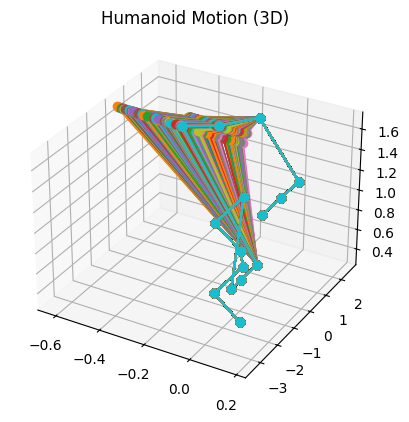

In [16]:
import pybullet as p
import pybullet_data
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

df = pd.read_csv("log.csv")

p.connect(p.DIRECT)
p.setAdditionalSearchPath(pybullet_data.getDataPath())
robot = p.loadURDF("humanoid/humanoid.urdf", [0,0,1], useFixedBase=True)

fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")

for i in range(0, len(df), 10):
    for j, q in enumerate(df.loc[i, ["q0","q1","q2","q3","q4","q5"]]):
        p.resetJointState(robot, j, q)

    points = []
    for j in range(p.getNumJoints(robot)):
        pos = p.getLinkState(robot, j)[0]
        points.append(pos)

    points = np.array(points)
    ax.plot(points[:,0], points[:,1], points[:,2], "-o")

ax.set_title("Humanoid Motion (3D)")
plt.show()

In [1]:
import pybullet as p
import pybullet_data


if p.isConnected():
    p.disconnect()

p.connect(p.GUI)
p.setAdditionalSearchPath(pybullet_data.getDataPath())
robot = p.loadURDF("humanoid/humanoid.urdf", [0,0,1])

for j in range(p.getNumJoints(robot)):
    info = p.getJointInfo(robot, j)
    print(j, info[1].decode("utf-8"), info[2])

p.disconnect()

0 root 4
1 chest 2
2 neck 2
3 right_shoulder 2
4 right_elbow 0
5 right_wrist 4
6 left_shoulder 2
7 left_elbow 0
8 left_wrist 4
9 right_hip 2
10 right_knee 0
11 right_ankle 2
12 left_hip 2
13 left_knee 0
14 left_ankle 2
